# River Dataset

## Two Locations: White River and Iowa River

### Whiter River: Longer Simulations roughly 50-102 timesteps
### Iowa River: Shorter Simulations roughly 21-22 timesteps

#### Iowa Simulations are H#iw.pt and White Simulations are simply H#.pt
#### They should be in the same training test val split already done
#### 9 Static Variables are the Terrain Descriptors 
#### 4 Dynamic Variables (What we want to predict) Water Depth, Volume, Velocity x, velocity y

In [2]:
def load_hec_ras_mesh_v2(hdf_path: Path, sim_id: str):
    """Specific loader using verified HEC-RAS internal paths."""
    with h5py.File(hdf_path, "r") as f:
        # Determine paths based on simulation type
        if "iw" in sim_id:
            # Iowa River / Flood GNN Mesh
            facepts_path = "Geometry/2D Flow Areas/Flow Area/FacePoints Coordinate"
            cells_path    = "Geometry/2D Flow Areas/Flow Area/Cells FacePoint Indexes"
        else:
            # White River / Muncie Mesh
            facepts_path = "Geometry/2D Flow Areas/Perimeter 1/FacePoints Coordinate"
            cells_path    = "Geometry/2D Flow Areas/Perimeter 1/Cells FacePoint Indexes"
            
        try:
            facepts = f[facepts_path][:]
            cells   = f[cells_path][:]
            print(f"✅ Mesh Loaded from {hdf_path.name}")
        except KeyError as e:
            print(f"❌ Path Error: Could not find {e} in {hdf_path.name}")
            # Diagnostic: Print what IS available
            print("Available groups in 'Geometry/2D Flow Areas':", list(f["Geometry/2D Flow Areas"].keys()))
            raise
            
    return facepts, cells

✅ Mesh Loaded from Flood_GNN.p01.hdf
🎨 Building polygons for clean rendering...


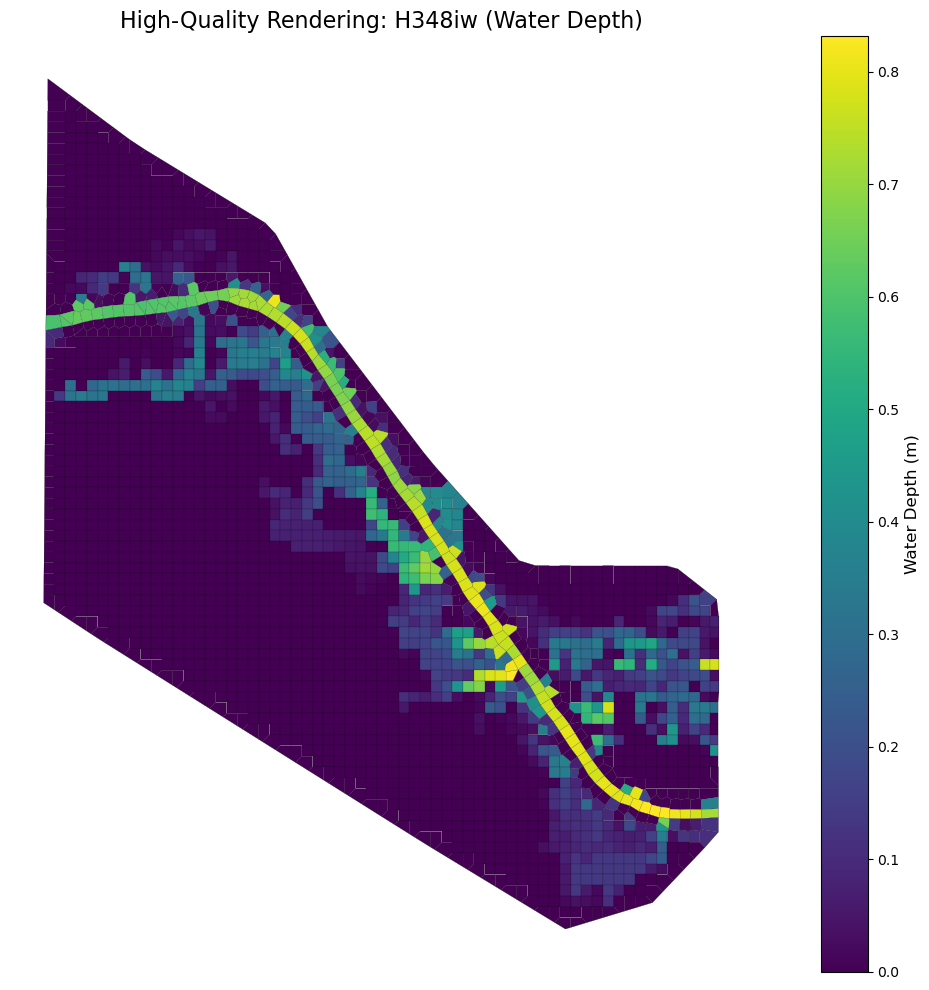

In [4]:
import torch
import pickle
import h5py
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.collections import PolyCollection
from pathlib import Path

def get_clean_polygons(facepts, cells):
    """
    Converts HEC-RAS facepts and padded cell indices into 
    a list of coordinate arrays for PolyCollection.
    """
    polys = []
    for cell_ids in cells:
        # Filter out the -1 padding used by HEC-RAS
        valid_ids = cell_ids[cell_ids >= 0].astype(int)
        # Grab the (x, y) coordinates for this cell's vertices
        pts = facepts[valid_ids]
        polys.append(pts)
    return polys

def run_nice_visualization():
    # --- 1. CONFIG & PATHS ---
    base_path = Path("/standard/sds_baek_energetic/HEC_RAS (River)")
    extrema_path = Path("/standard/sds_baek_energetic/HEC_RAS (River)/global_y_extrema_test.pth")
    
    sim_id = "H348iw"
    pt_path = base_path / "pt_val_normalized" / f"{sim_id}.pt"
    hdf_path = base_path / ("Flood_GNN.p01.hdf" if "iw" in sim_id else "Muncie2D_SI.p02.hdf")

    # 0 = Water Depth
    FEAT_IDX = 0 

    # --- 2. LOAD DATA ---
    # Load Extrema for Physical Units
    extrema = torch.load(extrema_path)
    y_min = extrema['y_min'][FEAT_IDX].item()
    y_max = extrema['y_max'][FEAT_IDX].item()

    # Load Converted Data
    conv_sim = torch.load(pt_path, weights_only=False)
    # Get y from Converted Step 0 and denormalize
    raw_vals = conv_sim[0].y[:, FEAT_IDX].numpy()
    phys_vals = raw_vals * (y_max - y_min) + y_min

    # Load Mesh using your verified paths
    facepts, cells = load_hec_ras_mesh_v2(hdf_path, sim_id)
    
    # --- 3. BUILD POLYGONS ---
    print("🎨 Building polygons for clean rendering...")
    polys = get_clean_polygons(facepts, cells)

    # --- 4. PLOTTING ---
    fig, ax = plt.subplots(figsize=(14, 10))

    # Create the PolyCollection
    # We color the faces based on our physical depth values
    pc = PolyCollection(polys, cmap='viridis', edgecolors='black', linewidths=0.1)
    pc.set_array(phys_vals)
    
    ax.add_collection(pc)
    
    # Auto-scale the view to fit the mesh
    ax.autoscale_view()
    
    # Add a nice colorbar
    cbar = fig.colorbar(pc, ax=ax)
    cbar.set_label("Water Depth (m)", fontsize=12)

    ax.set_aspect('equal')
    ax.axis('off') # Cleaner look for river maps
    
    plt.title(f"High-Quality Rendering: {sim_id} (Water Depth)", fontsize=16)
    plt.tight_layout()
    plt.show()

if __name__ == "__main__":
    run_nice_visualization()

In [8]:
import torch
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.collections import PolyCollection
from matplotlib.animation import FuncAnimation, PillowWriter
from pathlib import Path

def create_pt_only_gif(
    sim_id,
    output_name="pt_only.gif",
    var_idx=0,
    var_name="Water Depth"
):
    # --- 1. LOAD PT DATA ---
    base_path = Path("/standard/sds_baek_energetic/HEC_RAS (River)")
    pt_path = base_path / "pt_val_normalized" / f"{sim_id}.pt"
    conv_sim = torch.load(pt_path, weights_only=False)

    num_frames = len(conv_sim)
    print(f"📊 {sim_id}: {num_frames} PT timesteps")

    # --- 2. MESH ---
    is_flood_gnn = "iw" in sim_id
    hdf_path = base_path / (
        "Flood_GNN.p01.hdf" if is_flood_gnn else "Muncie2D_SI.p02.hdf"
    )
    facepts, cells = load_hec_ras_mesh_v2(hdf_path, sim_id)
    polys = [facepts[c[c >= 0].astype(int)] for c in cells]

    # --- 3. EXTREMA (PHYSICAL UNITS) ---
    extrema = torch.load(
        "/home/jtb3sud/G-PARC/demos/new_river/global_y_extrema_test.pth"
    )
    y_min = extrema["y_min"][var_idx].item()
    y_max = extrema["y_max"][var_idx].item()

    all_vals = [
        d.y[:, var_idx].numpy() * (y_max - y_min) + y_min
        for d in conv_sim
    ]
    v_min, v_max = np.min(all_vals), np.max(all_vals)

    # --- 4. FIGURE SETUP ---
    fig, ax = plt.subplots(1, 1, figsize=(10, 8))

    pc = PolyCollection(
        polys,
        cmap="viridis",
        edgecolors="black",
        linewidths=0.1
    )
    pc.set_clim(v_min, v_max)
    ax.add_collection(pc)
    ax.autoscale_view()
    ax.set_aspect("equal")
    ax.axis("off")

    ax.set_title(
        f"{sim_id} – {var_name}",
        fontsize=14,
        fontweight="bold"
    )

    # --- 5. COLORBAR ---
    cbar = fig.colorbar(pc, ax=ax, fraction=0.046, pad=0.02)
    cbar.set_label(var_name, fontsize=12)

    # --- 6. FRAME TEXT ---
    txt = fig.text(
        0.5, 0.94,
        "",
        ha="center",
        fontsize=13,
        fontweight="bold"
    )

    # --- 7. UPDATE FUNCTION ---
    def update(t):
        phys_vals = (
            conv_sim[t].y[:, var_idx].numpy()
            * (y_max - y_min)
            + y_min
        )
        pc.set_array(phys_vals)
        txt.set_text(f"{var_name} | Timestep {t+1}/{num_frames}")
        return pc, txt

    # --- 8. ANIMATION ---
    anim = FuncAnimation(
        fig,
        update,
        frames=num_frames,
        blit=False
    )

    print(f"🎬 Rendering {num_frames} frames...")
    anim.save(
        output_name,
        writer=PillowWriter(fps=4)
    )
    plt.close()
    print(f"✅ PT-only GIF saved as: {output_name}")


if __name__ == "__main__":
    create_pt_only_gif(
        sim_id="H30",
        output_name="white_river_pt_only.gif",
        var_idx=0,
        var_name="Water Depth (m)"
    )


📊 H30: 96 PT timesteps
✅ Mesh Loaded from Muncie2D_SI.p02.hdf
🎬 Rendering 96 frames...
✅ PT-only GIF saved as: white_river_pt_only.gif


# Elastoplasto Dataset

## Many Simulations: Each Simulation is a Different Mesh

#### 2 Static: Position variables x and y 
#### 3 Dynamic Variables: ux displacement, uy displacement, erosion (We predict two, ux, uy) 
#### Most simulations have the sametimestep

#### 2D_ElPlDynamics, standing for 2D elasto-plasto dynamics, is a dataset of 2D dynamic non-linear structural mechanics simulations, in large deformations and plane strain regimes, solved with Open-Radioss [75] using the finite element method. The material is modeled with a non-linear elastoplastic law, with damage (modeled using element erosion), failure and a non-local method for reducing mesh sensitivity. The dataset computes the transient deformation of a 2D structure, subjected to imposed displacement on the right and zero displacement on the left, see Figure 3 (left). Input variability in the dataset are the unstructured meshes (variable shape, number of nodes, connectivity and topology). Outputs of interest are 3 fields (U_x and U_y the displacement fields at the 4 nodes, and EROSION_STATUS a boolean field at the elements describing the state – valid or broken of each element)

# [https://arxiv.org/pdf/2505.02974]

Found 100 simulation files
Loading: simulation_105.pt
Loaded 40 timesteps, 24877 nodes, 49055 elements

Extracting data with erosion filtering...

Max eroded elements: 0 (0.0%)

Computing colorbar limits from valid elements only...
Max displacement (valid elements only): 16.3859
Deformed bounds: x=[-2.42, 4.36], y=[-4.28, 16.57]

Creating reference configuration GIF...
✓ Saved: reference_ground_truth.gif
Creating deformed configuration GIF...
✓ Saved: deformed_ground_truth.gif

REFERENCE CONFIGURATION (gray = eroded elements):


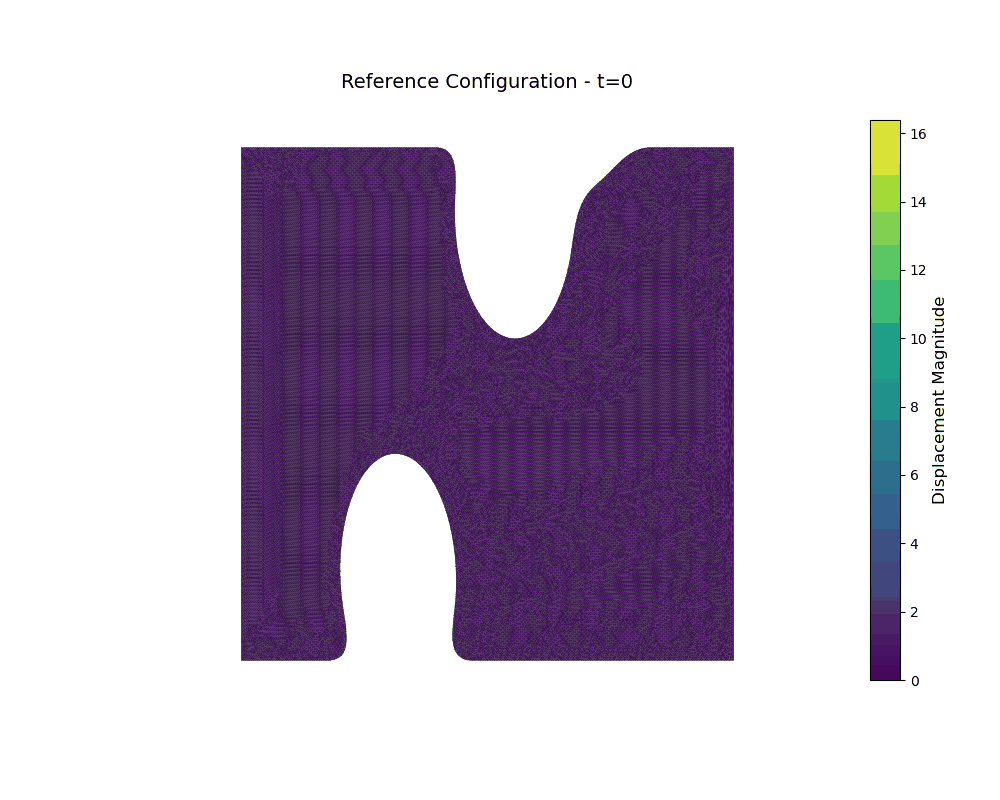


DEFORMED CONFIGURATION (eroded elements removed):


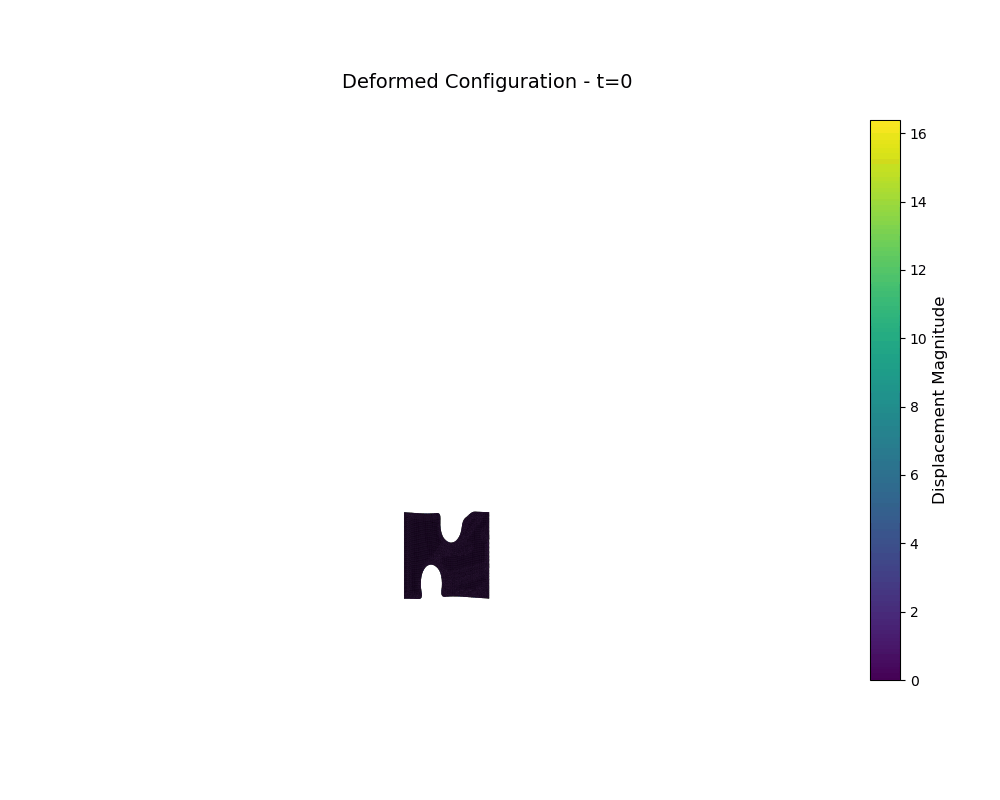

In [1]:
# ============================================================
# GROUND TRUTH VISUALIZATION - HANDLES NORMALIZED EROSION STATUS
# ============================================================
# Erosion status was z-score normalized:
#   - Valid elements (original 0) → ~0.0214
#   - Eroded elements (original 1) → large negative (e.g., -46.67)

import torch
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation, PillowWriter
from matplotlib.collections import PolyCollection
from matplotlib.colors import Normalize
import matplotlib.cm as cm
from pathlib import Path
from IPython.display import Image, display

# ============================================================
# CONFIGURATION - EDIT THESE
# ============================================================
DATA_DIR = "/scratch/jtb3sud/processed_elasto_plastic/zscore/normalized/test"
DATA_DIR = "/scratch/jtb3sud/processed_elasto_plastic/global_max/normalized/small/train"
SIM_INDEX = 0  # Which simulation to visualize
MAX_TIMESTEPS = 50  # Limit timesteps for faster rendering
OUTPUT_DIR = "."  # Where to save GIFs

# Erosion threshold: values below this are considered eroded
# (normalized erosion_status: valid ≈ 0.02, eroded ≈ -46.67)
EROSION_THRESHOLD = 0.5  # Anything below -1 is definitely eroded

# ============================================================
# LOAD DATA
# ============================================================
data_dir = Path(DATA_DIR)
files = sorted(list(data_dir.glob("*.pt")))
print(f"Found {len(files)} simulation files")

sim_file = files[SIM_INDEX]
print(f"Loading: {sim_file.name}")
simulation = torch.load(sim_file, weights_only=False)

# Extract reference data
first_data = simulation[0]
pos_ref = first_data.pos.cpu().numpy()
elements = first_data.elements.cpu().numpy()
x_ref, y_ref = pos_ref[:, 0], pos_ref[:, 1]

max_steps = min(len(simulation), MAX_TIMESTEPS)

print(f"Loaded {max_steps} timesteps, {len(pos_ref)} nodes, {len(elements)} elements")

# ============================================================
# EXTRACT DATA WITH EROSION HANDLING
# ============================================================
print("\nExtracting data with erosion filtering...")

displacements = []
erosion_masks = []  # True = eroded
erosion_counts = []

for t in range(max_steps):
    data = simulation[t]
    
    # Get displacement
    U = data.y.cpu().numpy()
    displacements.append(U)
    
    # Get erosion status (use y_element for current timestep's erosion state)
    # y_element contains EROSION_STATUS_t+1, but for visualization we want current state
    # x_element contains EROSION_STATUS_t
    if hasattr(data, 'x_element') and data.x_element is not None:
        erosion_normalized = data.x_element.cpu().numpy().flatten()
        # Eroded elements have large negative values after z-score normalization
        eroded_mask = erosion_normalized < EROSION_THRESHOLD
    else:
        # Fallback: no erosion data
        eroded_mask = np.zeros(len(elements), dtype=bool)
    
    erosion_masks.append(eroded_mask)
    erosion_counts.append(eroded_mask.sum())
    
    if t % 10 == 0 or eroded_mask.sum() > 0:
        if eroded_mask.sum() > 0:
            print(f"  t={t}: {eroded_mask.sum()} eroded elements ({100*eroded_mask.sum()/len(elements):.1f}%)")

print(f"\nMax eroded elements: {max(erosion_counts)} ({100*max(erosion_counts)/len(elements):.1f}%)")

# ============================================================
# COMPUTE COLORBAR LIMITS (only from valid elements/nodes)
# ============================================================
print("\nComputing colorbar limits from valid elements only...")

disp_max = 0
for t in range(max_steps):
    U = displacements[t]
    eroded_mask = erosion_masks[t]
    
    # Get nodes belonging to valid elements only
    valid_elements = elements[~eroded_mask]
    if len(valid_elements) > 0:
        valid_nodes = np.unique(valid_elements.flatten())
        u_mag = np.sqrt(U[valid_nodes, 0]**2 + U[valid_nodes, 1]**2)
        disp_max = max(disp_max, u_mag.max())

print(f"Max displacement (valid elements only): {disp_max:.4f}")

# ============================================================
# CAMERA BOUNDS
# ============================================================
pad = 0.1

# Reference bounds
x_min, x_max = x_ref.min(), x_ref.max()
y_min, y_max = y_ref.min(), y_ref.max()
pad_x, pad_y = (x_max - x_min) * pad, (y_max - y_min) * pad

# Deformed bounds (only from valid nodes)
def_x_min, def_x_max = x_min, x_max
def_y_min, def_y_max = y_min, y_max

for t in range(max_steps):
    U = displacements[t]
    eroded_mask = erosion_masks[t]
    valid_elements = elements[~eroded_mask]
    
    if len(valid_elements) > 0:
        valid_nodes = np.unique(valid_elements.flatten())
        x_def = x_ref[valid_nodes] + U[valid_nodes, 0]
        y_def = y_ref[valid_nodes] + U[valid_nodes, 1]
        def_x_min = min(def_x_min, x_def.min())
        def_x_max = max(def_x_max, x_def.max())
        def_y_min = min(def_y_min, y_def.min())
        def_y_max = max(def_y_max, y_def.max())

pad_x_def = (def_x_max - def_x_min) * pad
pad_y_def = (def_y_max - def_y_min) * pad

print(f"Deformed bounds: x=[{def_x_min:.2f}, {def_x_max:.2f}], y=[{def_y_min:.2f}, {def_y_max:.2f}]")

# ============================================================
# RENDERING FUNCTION
# ============================================================

def render_mesh_with_erosion(ax, pos, elements, node_values, eroded_mask,
                              vmin, vmax, cmap='viridis', 
                              show_eroded_ref=False, eroded_color='lightgray'):
    """
    Render mesh with eroded elements filtered out.
    
    Args:
        ax: matplotlib axis
        pos: node positions [N, 2]
        elements: element connectivity [M, 3]
        node_values: values at nodes [N]
        eroded_mask: boolean [M] - True = eroded element
        vmin, vmax: colorbar limits
        cmap: colormap
        show_eroded_ref: if True, show eroded elements in gray at reference position
        eroded_color: color for eroded elements
    """
    valid_mask = ~eroded_mask
    valid_elements = elements[valid_mask]
    eroded_elements = elements[eroded_mask]
    
    norm = Normalize(vmin=vmin, vmax=vmax)
    cmap_obj = plt.colormaps.get_cmap(cmap)
    
    # Render valid elements
    if len(valid_elements) > 0:
        polygons = []
        colors = []
        for elem in valid_elements:
            tri_verts = pos[elem]
            polygons.append(tri_verts)
            # Clip node values to valid range before averaging
            elem_vals = np.clip(node_values[elem], vmin, vmax)
            elem_val = elem_vals.mean()
            colors.append(cmap_obj(norm(elem_val)))
        
        pc = PolyCollection(polygons, facecolors=colors, edgecolors='k',
                           linewidths=0.1, alpha=1.0)
        ax.add_collection(pc)
    
    # Optionally show eroded elements at reference position (gray)
    if show_eroded_ref and len(eroded_elements) > 0:
        polygons = []
        for elem in eroded_elements:
            tri_verts = pos_ref[elem]  # Always use reference position for eroded
            polygons.append(tri_verts)
        
        pc_eroded = PolyCollection(polygons, facecolors=eroded_color, 
                                   edgecolors='gray', linewidths=0.1, alpha=0.3)
        ax.add_collection(pc_eroded)
    
    return len(valid_elements), len(eroded_elements)


# ============================================================
# 1. REFERENCE CONFIGURATION GIF
# ============================================================
print("\nCreating reference configuration GIF...")

fig_ref, ax_ref = plt.subplots(figsize=(10, 8))
fig_ref.subplots_adjust(right=0.85)
cax_ref = fig_ref.add_axes([0.87, 0.15, 0.03, 0.7])

sm_ref = cm.ScalarMappable(cmap='viridis', norm=Normalize(vmin=0, vmax=disp_max))
sm_ref.set_array([])
cbar_ref = fig_ref.colorbar(sm_ref, cax=cax_ref)
cbar_ref.set_label('Displacement Magnitude', fontsize=12)

def animate_reference(frame):
    ax_ref.clear()
    ax_ref.set_xlim(x_min - pad_x, x_max + pad_x)
    ax_ref.set_ylim(y_min - pad_y, y_max + pad_y)
    ax_ref.set_aspect('equal')
    ax_ref.axis('off')
    
    U = displacements[frame]
    disp_mag = np.sqrt(U[:, 0]**2 + U[:, 1]**2)
    eroded_mask = erosion_masks[frame]
    
    n_valid, n_eroded = render_mesh_with_erosion(
        ax_ref, pos_ref, elements, disp_mag, eroded_mask,
        vmin=0, vmax=disp_max, cmap='viridis', 
        show_eroded_ref=True, eroded_color='lightgray'
    )
    
    title = f'Reference Configuration - t={frame}'
    if n_eroded > 0:
        title += f' [{n_eroded} eroded]'
    ax_ref.set_title(title, fontsize=14)

anim_ref = FuncAnimation(fig_ref, animate_reference, frames=max_steps, interval=100)
ref_path = Path(OUTPUT_DIR) / 'reference_ground_truth.gif'
anim_ref.save(ref_path, writer=PillowWriter(fps=10))
plt.close(fig_ref)
print(f"✓ Saved: {ref_path}")

# ============================================================
# 2. DEFORMED CONFIGURATION GIF
# ============================================================
print("Creating deformed configuration GIF...")

fig_def, ax_def = plt.subplots(figsize=(10, 8))
fig_def.subplots_adjust(right=0.85)
cax_def = fig_def.add_axes([0.87, 0.15, 0.03, 0.7])

sm_def = cm.ScalarMappable(cmap='viridis', norm=Normalize(vmin=0, vmax=disp_max))
sm_def.set_array([])
cbar_def = fig_def.colorbar(sm_def, cax=cax_def)
cbar_def.set_label('Displacement Magnitude', fontsize=12)

def animate_deformed(frame):
    ax_def.clear()
    ax_def.set_xlim(def_x_min - pad_x_def, def_x_max + pad_x_def)
    ax_def.set_ylim(def_y_min - pad_y_def, def_y_max + pad_y_def)
    ax_def.set_aspect('equal')
    ax_def.axis('off')
    
    U = displacements[frame]
    pos_def = np.column_stack([x_ref + U[:, 0], y_ref + U[:, 1]])
    disp_mag = np.sqrt(U[:, 0]**2 + U[:, 1]**2)
    eroded_mask = erosion_masks[frame]
    
    # Only render valid elements (eroded elements have garbage positions)
    n_valid, n_eroded = render_mesh_with_erosion(
        ax_def, pos_def, elements, disp_mag, eroded_mask,
        vmin=0, vmax=disp_max, cmap='viridis',
        show_eroded_ref=False  # Don't show eroded in deformed view
    )
    
    title = f'Deformed Configuration - t={frame}'
    if n_eroded > 0:
        title += f' [{n_eroded} eroded]'
    ax_def.set_title(title, fontsize=14)

anim_def = FuncAnimation(fig_def, animate_deformed, frames=max_steps, interval=100)
def_path = Path(OUTPUT_DIR) / 'deformed_ground_truth.gif'
anim_def.save(def_path, writer=PillowWriter(fps=10))
plt.close(fig_def)
print(f"✓ Saved: {def_path}")

# ============================================================
# 3. EROSION PROGRESSION PLOT
# ============================================================
if max(erosion_counts) > 0:
    print("Creating erosion progression plot...")
    
    fig_ero, ax_ero = plt.subplots(figsize=(10, 4))
    ax_ero.plot(range(max_steps), erosion_counts, 'r-', linewidth=2, marker='o', markersize=3)
    ax_ero.fill_between(range(max_steps), erosion_counts, alpha=0.3, color='red')
    ax_ero.set_xlabel('Timestep', fontsize=12)
    ax_ero.set_ylabel('Eroded Elements', fontsize=12)
    ax_ero.set_title('Element Erosion Progression', fontsize=14)
    ax_ero.grid(alpha=0.3)
    ax_ero.set_xlim(0, max_steps-1)
    ax_ero.set_ylim(0, max(erosion_counts) * 1.1 + 1)
    
    # Add percentage on right axis
    ax_ero2 = ax_ero.twinx()
    ax_ero2.set_ylim(0, (max(erosion_counts) * 1.1 + 1) / len(elements) * 100)
    ax_ero2.set_ylabel('Eroded (%)', fontsize=12)
    
    ero_path = Path(OUTPUT_DIR) / 'erosion_progression.png'
    fig_ero.savefig(ero_path, dpi=150, bbox_inches='tight')
    plt.close(fig_ero)
    print(f"✓ Saved: {ero_path}")

# ============================================================
# DISPLAY
# ============================================================
print("\n" + "="*60)
print("REFERENCE CONFIGURATION (gray = eroded elements):")
print("="*60)
display(Image(filename=str(ref_path)))

print("\n" + "="*60)
print("DEFORMED CONFIGURATION (eroded elements removed):")
print("="*60)
display(Image(filename=str(def_path)))

if max(erosion_counts) > 0:
    print("\n" + "="*60)
    print("EROSION PROGRESSION:")
    print("="*60)
    display(Image(filename=str(ero_path)))

Found 100 simulation files
Loading: simulation_105.pt
Loaded 40 timesteps, 24877 nodes, 49055 elements

Extracting data with erosion filtering...
  t=35: 51 eroded elements (0.1%)
  t=36: 88 eroded elements (0.2%)
  t=37: 114 eroded elements (0.2%)
  t=38: 127 eroded elements (0.3%)
  t=39: 136 eroded elements (0.3%)

Max eroded elements: 136 (0.3%)

Computing colorbar limits from valid elements only...
Max displacement (valid elements only): 0.0372
Deformed bounds: x=[0.00, 200.04], y=[-0.01, 100.01]

Creating reference configuration GIF...
✓ Saved: reference_ground_truth.gif
Creating deformed configuration GIF...
✓ Saved: deformed_ground_truth.gif
Creating erosion progression plot...
✓ Saved: erosion_progression.png

REFERENCE CONFIGURATION (gray = eroded elements):


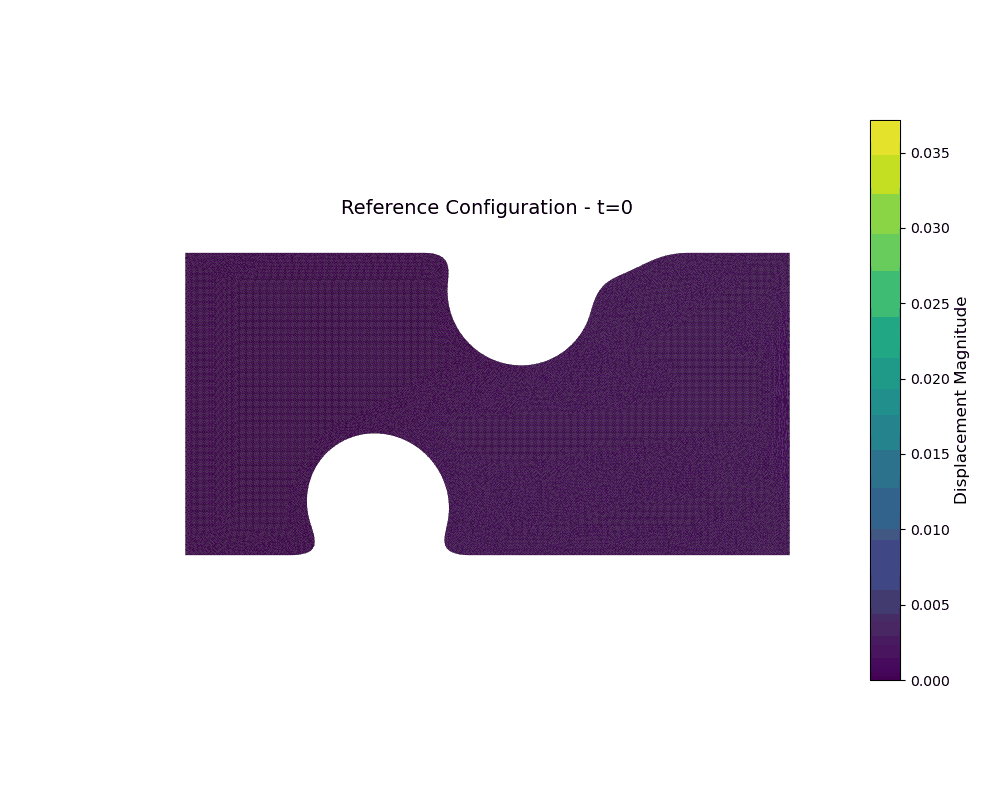


DEFORMED CONFIGURATION (eroded elements removed):


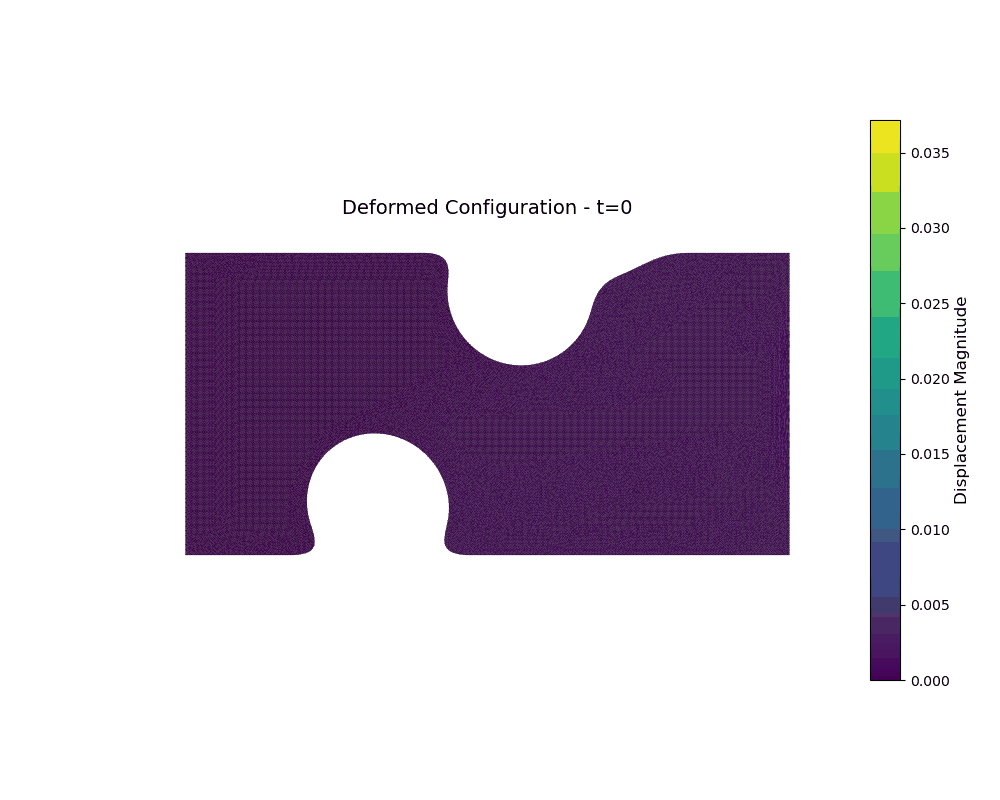


EROSION PROGRESSION:


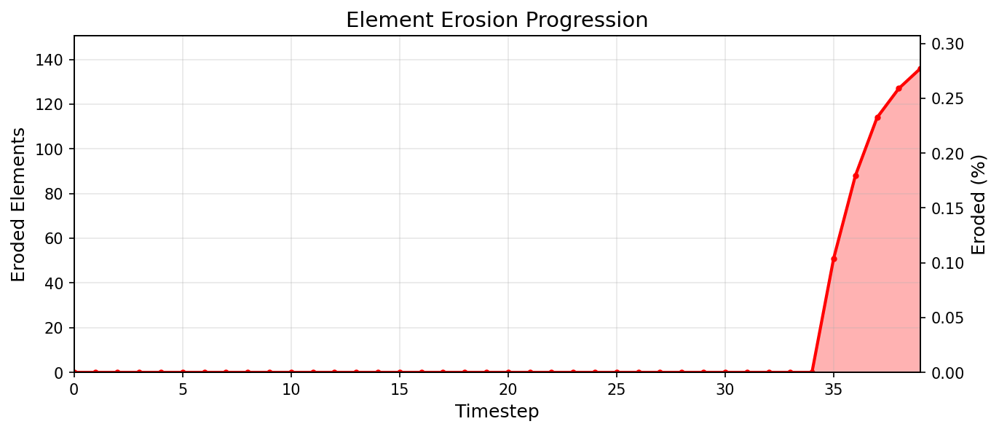

In [2]:
# ============================================================
# GROUND TRUTH VISUALIZATION - HANDLES NORMALIZED EROSION STATUS
# ============================================================
# Erosion status was z-score normalized:
#   - Valid elements (original 0) → ~0.0214
#   - Eroded elements (original 1) → large negative (e.g., -46.67)

import torch
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation, PillowWriter
from matplotlib.collections import PolyCollection
from matplotlib.colors import Normalize
import matplotlib.cm as cm
from pathlib import Path
from IPython.display import Image, display

# ============================================================
# CONFIGURATION - EDIT THESE
# ============================================================
DATA_DIR = "/scratch/jtb3sud/processed_elasto_plastic/zscore/normalized/test"
DATA_DIR = "/scratch/jtb3sud/processed_elasto_plastic/global_max/normalized/test"
SIM_INDEX = 0  # Which simulation to visualize
MAX_TIMESTEPS = 50  # Limit timesteps for faster rendering
OUTPUT_DIR = "."  # Where to save GIFs

# Erosion threshold: values below this are considered eroded
# (normalized erosion_status: valid ≈ 0.02, eroded ≈ -46.67)
EROSION_THRESHOLD = 0.5  # Anything below -1 is definitely eroded

# ============================================================
# LOAD DATA
# ============================================================
data_dir = Path(DATA_DIR)
files = sorted(list(data_dir.glob("*.pt")))
print(f"Found {len(files)} simulation files")

sim_file = files[SIM_INDEX]
print(f"Loading: {sim_file.name}")
simulation = torch.load(sim_file, weights_only=False)

# Extract reference data
first_data = simulation[0]
pos_ref = first_data.pos.cpu().numpy()
elements = first_data.elements.cpu().numpy()
x_ref, y_ref = pos_ref[:, 0], pos_ref[:, 1]

max_steps = min(len(simulation), MAX_TIMESTEPS)

print(f"Loaded {max_steps} timesteps, {len(pos_ref)} nodes, {len(elements)} elements")

# ============================================================
# EXTRACT DATA WITH EROSION HANDLING
# ============================================================
print("\nExtracting data with erosion filtering...")

displacements = []
erosion_masks = []  # True = eroded
erosion_counts = []

for t in range(max_steps):
    data = simulation[t]
    
    # Get displacement
    U = data.y.cpu().numpy()
    displacements.append(U)
    
    # Get erosion status (use y_element for current timestep's erosion state)
    # y_element contains EROSION_STATUS_t+1, but for visualization we want current state
    # x_element contains EROSION_STATUS_t
    if hasattr(data, 'x_element') and data.x_element is not None:
        erosion_normalized = data.x_element.cpu().numpy().flatten()
        # Eroded elements have large negative values after z-score normalization
        eroded_mask = erosion_normalized < EROSION_THRESHOLD
    else:
        # Fallback: no erosion data
        eroded_mask = np.zeros(len(elements), dtype=bool)
    
    erosion_masks.append(eroded_mask)
    erosion_counts.append(eroded_mask.sum())
    
    if t % 10 == 0 or eroded_mask.sum() > 0:
        if eroded_mask.sum() > 0:
            print(f"  t={t}: {eroded_mask.sum()} eroded elements ({100*eroded_mask.sum()/len(elements):.1f}%)")

print(f"\nMax eroded elements: {max(erosion_counts)} ({100*max(erosion_counts)/len(elements):.1f}%)")

# ============================================================
# COMPUTE COLORBAR LIMITS (only from valid elements/nodes)
# ============================================================
print("\nComputing colorbar limits from valid elements only...")

disp_max = 0
for t in range(max_steps):
    U = displacements[t]
    eroded_mask = erosion_masks[t]
    
    # Get nodes belonging to valid elements only
    valid_elements = elements[~eroded_mask]
    if len(valid_elements) > 0:
        valid_nodes = np.unique(valid_elements.flatten())
        u_mag = np.sqrt(U[valid_nodes, 0]**2 + U[valid_nodes, 1]**2)
        disp_max = max(disp_max, u_mag.max())

print(f"Max displacement (valid elements only): {disp_max:.4f}")

# ============================================================
# CAMERA BOUNDS
# ============================================================
pad = 0.1

# Reference bounds
x_min, x_max = x_ref.min(), x_ref.max()
y_min, y_max = y_ref.min(), y_ref.max()
pad_x, pad_y = (x_max - x_min) * pad, (y_max - y_min) * pad

# Deformed bounds (only from valid nodes)
def_x_min, def_x_max = x_min, x_max
def_y_min, def_y_max = y_min, y_max

for t in range(max_steps):
    U = displacements[t]
    eroded_mask = erosion_masks[t]
    valid_elements = elements[~eroded_mask]
    
    if len(valid_elements) > 0:
        valid_nodes = np.unique(valid_elements.flatten())
        x_def = x_ref[valid_nodes] + U[valid_nodes, 0]
        y_def = y_ref[valid_nodes] + U[valid_nodes, 1]
        def_x_min = min(def_x_min, x_def.min())
        def_x_max = max(def_x_max, x_def.max())
        def_y_min = min(def_y_min, y_def.min())
        def_y_max = max(def_y_max, y_def.max())

pad_x_def = (def_x_max - def_x_min) * pad
pad_y_def = (def_y_max - def_y_min) * pad

print(f"Deformed bounds: x=[{def_x_min:.2f}, {def_x_max:.2f}], y=[{def_y_min:.2f}, {def_y_max:.2f}]")

# ============================================================
# RENDERING FUNCTION
# ============================================================

def render_mesh_with_erosion(ax, pos, elements, node_values, eroded_mask,
                              vmin, vmax, cmap='viridis', 
                              show_eroded_ref=False, eroded_color='lightgray'):
    """
    Render mesh with eroded elements filtered out.
    
    Args:
        ax: matplotlib axis
        pos: node positions [N, 2]
        elements: element connectivity [M, 3]
        node_values: values at nodes [N]
        eroded_mask: boolean [M] - True = eroded element
        vmin, vmax: colorbar limits
        cmap: colormap
        show_eroded_ref: if True, show eroded elements in gray at reference position
        eroded_color: color for eroded elements
    """
    valid_mask = ~eroded_mask
    valid_elements = elements[valid_mask]
    eroded_elements = elements[eroded_mask]
    
    norm = Normalize(vmin=vmin, vmax=vmax)
    cmap_obj = plt.colormaps.get_cmap(cmap)
    
    # Render valid elements
    if len(valid_elements) > 0:
        polygons = []
        colors = []
        for elem in valid_elements:
            tri_verts = pos[elem]
            polygons.append(tri_verts)
            # Clip node values to valid range before averaging
            elem_vals = np.clip(node_values[elem], vmin, vmax)
            elem_val = elem_vals.mean()
            colors.append(cmap_obj(norm(elem_val)))
        
        pc = PolyCollection(polygons, facecolors=colors, edgecolors='k',
                           linewidths=0.1, alpha=1.0)
        ax.add_collection(pc)
    
    # Optionally show eroded elements at reference position (gray)
    if show_eroded_ref and len(eroded_elements) > 0:
        polygons = []
        for elem in eroded_elements:
            tri_verts = pos_ref[elem]  # Always use reference position for eroded
            polygons.append(tri_verts)
        
        pc_eroded = PolyCollection(polygons, facecolors=eroded_color, 
                                   edgecolors='gray', linewidths=0.1, alpha=0.3)
        ax.add_collection(pc_eroded)
    
    return len(valid_elements), len(eroded_elements)


# ============================================================
# 1. REFERENCE CONFIGURATION GIF
# ============================================================
print("\nCreating reference configuration GIF...")

fig_ref, ax_ref = plt.subplots(figsize=(10, 8))
fig_ref.subplots_adjust(right=0.85)
cax_ref = fig_ref.add_axes([0.87, 0.15, 0.03, 0.7])

sm_ref = cm.ScalarMappable(cmap='viridis', norm=Normalize(vmin=0, vmax=disp_max))
sm_ref.set_array([])
cbar_ref = fig_ref.colorbar(sm_ref, cax=cax_ref)
cbar_ref.set_label('Displacement Magnitude', fontsize=12)

def animate_reference(frame):
    ax_ref.clear()
    ax_ref.set_xlim(x_min - pad_x, x_max + pad_x)
    ax_ref.set_ylim(y_min - pad_y, y_max + pad_y)
    ax_ref.set_aspect('equal')
    ax_ref.axis('off')
    
    U = displacements[frame]
    disp_mag = np.sqrt(U[:, 0]**2 + U[:, 1]**2)
    eroded_mask = erosion_masks[frame]
    
    n_valid, n_eroded = render_mesh_with_erosion(
        ax_ref, pos_ref, elements, disp_mag, eroded_mask,
        vmin=0, vmax=disp_max, cmap='viridis', 
        show_eroded_ref=True, eroded_color='lightgray'
    )
    
    title = f'Reference Configuration - t={frame}'
    if n_eroded > 0:
        title += f' [{n_eroded} eroded]'
    ax_ref.set_title(title, fontsize=14)

anim_ref = FuncAnimation(fig_ref, animate_reference, frames=max_steps, interval=100)
ref_path = Path(OUTPUT_DIR) / 'reference_ground_truth.gif'
anim_ref.save(ref_path, writer=PillowWriter(fps=10))
plt.close(fig_ref)
print(f"✓ Saved: {ref_path}")

# ============================================================
# 2. DEFORMED CONFIGURATION GIF
# ============================================================
print("Creating deformed configuration GIF...")

fig_def, ax_def = plt.subplots(figsize=(10, 8))
fig_def.subplots_adjust(right=0.85)
cax_def = fig_def.add_axes([0.87, 0.15, 0.03, 0.7])

sm_def = cm.ScalarMappable(cmap='viridis', norm=Normalize(vmin=0, vmax=disp_max))
sm_def.set_array([])
cbar_def = fig_def.colorbar(sm_def, cax=cax_def)
cbar_def.set_label('Displacement Magnitude', fontsize=12)

def animate_deformed(frame):
    ax_def.clear()
    ax_def.set_xlim(def_x_min - pad_x_def, def_x_max + pad_x_def)
    ax_def.set_ylim(def_y_min - pad_y_def, def_y_max + pad_y_def)
    ax_def.set_aspect('equal')
    ax_def.axis('off')
    
    U = displacements[frame]
    pos_def = np.column_stack([x_ref + U[:, 0], y_ref + U[:, 1]])
    disp_mag = np.sqrt(U[:, 0]**2 + U[:, 1]**2)
    eroded_mask = erosion_masks[frame]
    
    # Only render valid elements (eroded elements have garbage positions)
    n_valid, n_eroded = render_mesh_with_erosion(
        ax_def, pos_def, elements, disp_mag, eroded_mask,
        vmin=0, vmax=disp_max, cmap='viridis',
        show_eroded_ref=False  # Don't show eroded in deformed view
    )
    
    title = f'Deformed Configuration - t={frame}'
    if n_eroded > 0:
        title += f' [{n_eroded} eroded]'
    ax_def.set_title(title, fontsize=14)

anim_def = FuncAnimation(fig_def, animate_deformed, frames=max_steps, interval=100)
def_path = Path(OUTPUT_DIR) / 'deformed_ground_truth.gif'
anim_def.save(def_path, writer=PillowWriter(fps=10))
plt.close(fig_def)
print(f"✓ Saved: {def_path}")

# ============================================================
# 3. EROSION PROGRESSION PLOT
# ============================================================
if max(erosion_counts) > 0:
    print("Creating erosion progression plot...")
    
    fig_ero, ax_ero = plt.subplots(figsize=(10, 4))
    ax_ero.plot(range(max_steps), erosion_counts, 'r-', linewidth=2, marker='o', markersize=3)
    ax_ero.fill_between(range(max_steps), erosion_counts, alpha=0.3, color='red')
    ax_ero.set_xlabel('Timestep', fontsize=12)
    ax_ero.set_ylabel('Eroded Elements', fontsize=12)
    ax_ero.set_title('Element Erosion Progression', fontsize=14)
    ax_ero.grid(alpha=0.3)
    ax_ero.set_xlim(0, max_steps-1)
    ax_ero.set_ylim(0, max(erosion_counts) * 1.1 + 1)
    
    # Add percentage on right axis
    ax_ero2 = ax_ero.twinx()
    ax_ero2.set_ylim(0, (max(erosion_counts) * 1.1 + 1) / len(elements) * 100)
    ax_ero2.set_ylabel('Eroded (%)', fontsize=12)
    
    ero_path = Path(OUTPUT_DIR) / 'erosion_progression.png'
    fig_ero.savefig(ero_path, dpi=150, bbox_inches='tight')
    plt.close(fig_ero)
    print(f"✓ Saved: {ero_path}")

# ============================================================
# DISPLAY
# ============================================================
print("\n" + "="*60)
print("REFERENCE CONFIGURATION (gray = eroded elements):")
print("="*60)
display(Image(filename=str(ref_path)))

print("\n" + "="*60)
print("DEFORMED CONFIGURATION (eroded elements removed):")
print("="*60)
display(Image(filename=str(def_path)))

if max(erosion_counts) > 0:
    print("\n" + "="*60)
    print("EROSION PROGRESSION:")
    print("="*60)
    display(Image(filename=str(ero_path)))

In [1]:
#!/usr/bin/env python3
"""
Erosion Data Exploration Script
===============================
Understand what erosion data is available and how it evolves
to inform how to add erosion prediction to the model.
"""

import torch
import numpy as np
from pathlib import Path
from collections import defaultdict

# ============================================================
# CONFIGURATION
# ============================================================
DATA_DIR = "/scratch/jtb3sud/processed_elasto_plastic/zscore/normalized/train"
NUM_SIMS_TO_EXPLORE = 5  # How many simulations to look at
EROSION_THRESHOLD = -1.0

# ============================================================
# LOAD AND EXPLORE
# ============================================================
data_dir = Path(DATA_DIR)
files = sorted(list(data_dir.glob("*.pt")))
print(f"Found {len(files)} simulation files\n")

# ============================================================
# 1. BASIC DATA STRUCTURE
# ============================================================
print("="*70)
print("1. DATA STRUCTURE EXPLORATION")
print("="*70)

sim = torch.load(files[0], weights_only=False)
data0 = sim[0]

print(f"\nSimulation length: {len(sim)} timesteps")
print(f"\nData object attributes:")
for key in sorted(data0.keys()):
    val = data0[key]
    if torch.is_tensor(val):
        print(f"  {key:20s}: shape={str(val.shape):20s} dtype={val.dtype}")
    else:
        print(f"  {key:20s}: {type(val).__name__}")

# ============================================================
# 2. NODE vs ELEMENT LEVEL DATA
# ============================================================
print("\n" + "="*70)
print("2. NODE vs ELEMENT LEVEL DATA")
print("="*70)

num_nodes = data0.x.shape[0]
num_elements = data0.elements.shape[0] if hasattr(data0, 'elements') else 'N/A'

print(f"\nNumber of nodes: {num_nodes}")
print(f"Number of elements: {num_elements}")

# Check what's node-level vs element-level
print("\nNode-level fields (shape[0] == num_nodes):")
for key in data0.keys():
    val = data0[key]
    if torch.is_tensor(val) and len(val.shape) > 0 and val.shape[0] == num_nodes:
        print(f"  {key}: {val.shape}")

print("\nElement-level fields (shape[0] == num_elements):")
for key in data0.keys():
    val = data0[key]
    if torch.is_tensor(val) and len(val.shape) > 0 and val.shape[0] == num_elements:
        print(f"  {key}: {val.shape}")

# ============================================================
# 3. EROSION STATUS EXPLORATION
# ============================================================
print("\n" + "="*70)
print("3. EROSION STATUS EXPLORATION")
print("="*70)

if hasattr(data0, 'x_element'):
    print("\nx_element (input erosion status at time t):")
    x_elem = data0.x_element.numpy().flatten()
    print(f"  Shape: {data0.x_element.shape}")
    print(f"  Min: {x_elem.min():.4f}")
    print(f"  Max: {x_elem.max():.4f}")
    print(f"  Mean: {x_elem.mean():.4f}")
    print(f"  Unique values: {len(np.unique(x_elem))}")
    
    # Count eroded vs valid
    eroded = x_elem < EROSION_THRESHOLD
    print(f"  Eroded (< {EROSION_THRESHOLD}): {eroded.sum()} ({100*eroded.mean():.2f}%)")
    print(f"  Valid: {(~eroded).sum()} ({100*(~eroded).mean():.2f}%)")
    
    # Show distribution of values
    print(f"\n  Value distribution:")
    print(f"    Values near 0 (valid): {(np.abs(x_elem) < 0.5).sum()}")
    print(f"    Values < -1 (eroded): {(x_elem < -1).sum()}")
    print(f"    Values < -10: {(x_elem < -10).sum()}")
    print(f"    Values < -40: {(x_elem < -40).sum()}")
else:
    print("\nWARNING: No x_element field found!")

if hasattr(data0, 'y_element'):
    print("\ny_element (target erosion status at time t+1):")
    y_elem = data0.y_element.numpy().flatten()
    print(f"  Shape: {data0.y_element.shape}")
    print(f"  Min: {y_elem.min():.4f}")
    print(f"  Max: {y_elem.max():.4f}")
    print(f"  Mean: {y_elem.mean():.4f}")
    
    eroded = y_elem < EROSION_THRESHOLD
    print(f"  Eroded (< {EROSION_THRESHOLD}): {eroded.sum()} ({100*eroded.mean():.2f}%)")
else:
    print("\nNo y_element field - erosion target not available!")

# ============================================================
# 4. EROSION EVOLUTION OVER TIME
# ============================================================
print("\n" + "="*70)
print("4. EROSION EVOLUTION OVER TIME (first simulation)")
print("="*70)

erosion_timeline = []
new_erosions = []

for t in range(len(sim)):
    data = sim[t]
    if hasattr(data, 'x_element'):
        x_elem = data.x_element.numpy().flatten()
        n_eroded = (x_elem < EROSION_THRESHOLD).sum()
        erosion_timeline.append(n_eroded)
        
        if t > 0:
            new = n_eroded - erosion_timeline[t-1]
            new_erosions.append(new)

if erosion_timeline:
    print(f"\nTimestep | Eroded Elements | New Erosions")
    print("-" * 45)
    for t in range(0, len(erosion_timeline), max(1, len(erosion_timeline)//20)):
        new = new_erosions[t-1] if t > 0 else 0
        print(f"  {t:4d}   |     {erosion_timeline[t]:5d}       |    {new:+4d}")
    
    print(f"\nSummary:")
    print(f"  Initial eroded: {erosion_timeline[0]}")
    print(f"  Final eroded: {erosion_timeline[-1]}")
    print(f"  Total new erosions: {erosion_timeline[-1] - erosion_timeline[0]}")
    print(f"  Max new erosions in single step: {max(new_erosions) if new_erosions else 0}")

# ============================================================
# 5. RELATIONSHIP BETWEEN x_element AND y_element
# ============================================================
print("\n" + "="*70)
print("5. x_element vs y_element RELATIONSHIP")
print("="*70)

if hasattr(data0, 'x_element') and hasattr(data0, 'y_element'):
    # Check multiple timesteps
    transitions = defaultdict(int)
    
    for t in range(min(10, len(sim))):
        data = sim[t]
        x_elem = data.x_element.numpy().flatten()
        y_elem = data.y_element.numpy().flatten()
        
        x_eroded = x_elem < EROSION_THRESHOLD
        y_eroded = y_elem < EROSION_THRESHOLD
        
        # Count transitions
        transitions['valid->valid'] += ((~x_eroded) & (~y_eroded)).sum()
        transitions['valid->eroded'] += ((~x_eroded) & (y_eroded)).sum()
        transitions['eroded->valid'] += ((x_eroded) & (~y_eroded)).sum()
        transitions['eroded->eroded'] += ((x_eroded) & (y_eroded)).sum()
    
    print("\nTransitions over first 10 timesteps:")
    for trans, count in sorted(transitions.items()):
        print(f"  {trans:20s}: {count:8d}")
    
    print(f"\nKey insight:")
    if transitions['eroded->valid'] == 0:
        print("  ✓ Erosion is IRREVERSIBLE (once eroded, always eroded)")
    else:
        print("  ⚠ Some elements un-erode (eroded->valid)!")
    
    if transitions['valid->eroded'] > 0:
        print(f"  ✓ New erosions occur: {transitions['valid->eroded']} elements eroded")
else:
    print("\nCannot analyze - missing x_element or y_element")

# ============================================================
# 6. EROSION PATTERNS ACROSS SIMULATIONS
# ============================================================
print("\n" + "="*70)
print("6. EROSION PATTERNS ACROSS SIMULATIONS")
print("="*70)

sim_stats = []
for i, f in enumerate(files[:NUM_SIMS_TO_EXPLORE]):
    sim = torch.load(f, weights_only=False)
    
    initial_eroded = 0
    final_eroded = 0
    max_eroded = 0
    
    if hasattr(sim[0], 'x_element'):
        initial_eroded = (sim[0].x_element.numpy().flatten() < EROSION_THRESHOLD).sum()
    
    if hasattr(sim[-1], 'x_element'):
        final_eroded = (sim[-1].x_element.numpy().flatten() < EROSION_THRESHOLD).sum()
    
    for t in range(len(sim)):
        if hasattr(sim[t], 'x_element'):
            n = (sim[t].x_element.numpy().flatten() < EROSION_THRESHOLD).sum()
            max_eroded = max(max_eroded, n)
    
    sim_stats.append({
        'file': f.name,
        'timesteps': len(sim),
        'elements': sim[0].elements.shape[0],
        'initial_eroded': initial_eroded,
        'final_eroded': final_eroded,
        'max_eroded': max_eroded
    })
    
    print(f"\nSimulation {i}: {f.name}")
    print(f"  Timesteps: {len(sim)}, Elements: {sim[0].elements.shape[0]}")
    print(f"  Erosion: {initial_eroded} → {final_eroded} (max: {max_eroded})")

# ============================================================
# 7. WHAT PREDICTS EROSION?
# ============================================================
print("\n" + "="*70)
print("7. POTENTIAL EROSION PREDICTORS")
print("="*70)

# Reload first sim
sim = torch.load(files[0], weights_only=False)

# Find a timestep where new erosion occurs
for t in range(1, len(sim)):
    data_prev = sim[t-1]
    data_curr = sim[t]
    
    if not hasattr(data_curr, 'x_element'):
        continue
    
    x_prev = data_prev.x_element.numpy().flatten()
    x_curr = data_curr.x_element.numpy().flatten()
    
    prev_eroded = x_prev < EROSION_THRESHOLD
    curr_eroded = x_curr < EROSION_THRESHOLD
    
    newly_eroded = (~prev_eroded) & (curr_eroded)
    
    if newly_eroded.sum() > 0:
        print(f"\nFound {newly_eroded.sum()} newly eroded elements at timestep {t}")
        
        # Get node-level data for elements that eroded
        elements = data_prev.elements.numpy()
        newly_eroded_elements = elements[newly_eroded]
        newly_eroded_nodes = np.unique(newly_eroded_elements.flatten())
        
        # Compare displacement magnitude
        y_prev = data_prev.y.numpy()  # Displacement
        
        all_disp_mag = np.sqrt(y_prev[:, 0]**2 + y_prev[:, 1]**2)
        eroded_disp_mag = all_disp_mag[newly_eroded_nodes]
        
        print(f"\nDisplacement magnitude comparison:")
        print(f"  All nodes:     mean={all_disp_mag.mean():.4f}, max={all_disp_mag.max():.4f}")
        print(f"  Eroded nodes:  mean={eroded_disp_mag.mean():.4f}, max={eroded_disp_mag.max():.4f}")
        
        # Check if there's strain or stress data
        if hasattr(data_prev, 'x') and data_prev.x.shape[1] > 2:
            print(f"\nAdditional features in x: {data_prev.x.shape[1]} total")
            # Could analyze other features here
        
        break

# ============================================================
# 8. SUMMARY AND RECOMMENDATIONS
# ============================================================
print("\n" + "="*70)
print("8. SUMMARY FOR MODEL DESIGN")
print("="*70)

print("""
Based on exploration:

1. EROSION DATA AVAILABLE:
   - x_element: current erosion status (input)
   - y_element: next timestep erosion status (target)
   
2. EROSION IS ELEMENT-LEVEL:
   - Need to decide: predict element-level or node-level?
   - Element-level is more natural for erosion physics
   
3. EROSION IS IRREVERSIBLE:
   - Once eroded, always eroded
   - Model only needs to predict valid → eroded transitions
   
4. PREDICTION TASK OPTIONS:
   
   Option A: Binary classification per element
   - Input: current state (displacements, positions, features)
   - Output: P(element erodes at next timestep)
   - Loss: Binary cross-entropy
   
   Option B: Predict erosion status directly
   - Input: current state
   - Output: erosion status value (regression)
   - Loss: MSE on erosion status
   
   Option C: Joint displacement + erosion
   - Predict both displacement AND erosion probability
   - Mask displacement loss for already-eroded elements
   - This is probably what you want!

5. ARCHITECTURE CONSIDERATIONS:
   - Current model: node-level predictions
   - Erosion: element-level
   - Need: element pooling or element-wise head
""")

Found 750 simulation files

1. DATA STRUCTURE EXPLORATION

Simulation length: 40 timesteps

Data object attributes:
  edge_index          : shape=torch.Size([2, 149166]) dtype=torch.int64
  elements            : shape=torch.Size([49431, 3]) dtype=torch.int64
  global_params       : shape=torch.Size([0])      dtype=torch.float32
  pos                 : shape=torch.Size([25152, 2]) dtype=torch.float32
  sample_id           : str
  time_current        : int64
  time_next           : float64
  x                   : shape=torch.Size([25152, 4]) dtype=torch.float32
  x_element           : shape=torch.Size([49431, 1]) dtype=torch.float32
  y                   : shape=torch.Size([25152, 2]) dtype=torch.float32
  y_element           : shape=torch.Size([49431, 1]) dtype=torch.float32

2. NODE vs ELEMENT LEVEL DATA

Number of nodes: 25152
Number of elements: 49431

Node-level fields (shape[0] == num_nodes):
  pos: torch.Size([25152, 2])
  x: torch.Size([25152, 4])
  y: torch.Size([25152, 2])

Ele

In [2]:
# Quick feature inspection
sim = torch.load(files[0], weights_only=False)
data0 = sim[0]

print("Node features (x):")
for i in range(data0.x.shape[1]):
    col = data0.x[:, i]
    print(f"  x[:, {i}]: min={col.min():.4f}, max={col.max():.4f}, mean={col.mean():.4f}")

print("\nElement features:")
print(f"  x_element: min={data0.x_element.min():.4f}, max={data0.x_element.max():.4f}")
print(f"  y_element: min={data0.y_element.min():.4f}, max={data0.y_element.max():.4f}")

# Check a timestep WITH erosion
data20 = sim[20]
print(f"\nAt timestep 20 (when erosion starts):")
print(f"  x_element unique values: {torch.unique(data20.x_element)}")
print(f"  y_element unique values: {torch.unique(data20.y_element)}")

Node features (x):
  x[:, 0]: min=-1.6372, max=1.7309, mean=-0.0157
  x[:, 1]: min=-1.7648, max=1.7470, mean=-0.0398
  x[:, 2]: min=-0.7833, max=-0.7833, mean=-0.7833
  x[:, 3]: min=0.0041, max=0.0041, mean=0.0041

Element features:
  x_element: min=0.0214, max=0.0214
  y_element: min=0.0214, max=0.0214

At timestep 20 (when erosion starts):
  x_element unique values: tensor([-4.6666e+01,  2.1428e-02])
  y_element unique values: tensor([-4.6666e+01,  2.1428e-02])


In [3]:
# Check if x[:, 2] and x[:, 3] vary across simulations
for i in range(5):
    sim = torch.load(files[i], weights_only=False)
    data0 = sim[0]
    print(f"Sim {i}: x[:,2]={data0.x[0, 2]:.4f}, x[:,3]={data0.x[0, 3]:.4f}")

Sim 0: x[:,2]=-0.7833, x[:,3]=0.0041
Sim 1: x[:,2]=-0.7833, x[:,3]=0.0041
Sim 2: x[:,2]=-0.7833, x[:,3]=0.0041
Sim 3: x[:,2]=-0.7833, x[:,3]=0.0041
Sim 4: x[:,2]=-0.7833, x[:,3]=0.0041


In [4]:
sim = torch.load(files[0], weights_only=False)
data0 = sim[0]

print("Comparing pos vs x[:, 0:2]:")
print(f"  pos[:, 0] range: [{data0.pos[:, 0].min():.4f}, {data0.pos[:, 0].max():.4f}]")
print(f"  x[:, 0] range:   [{data0.x[:, 0].min():.4f}, {data0.x[:, 0].max():.4f}]")
print(f"  Are they equal?  {torch.allclose(data0.pos, data0.x[:, :2])}")

Comparing pos vs x[:, 0:2]:
  pos[:, 0] range: [-1.6372, 1.7309]
  x[:, 0] range:   [-1.6372, 1.7309]
  Are they equal?  True


In [5]:
# Load RAW data
RAW_DIR = Path("/scratch/jtb3sud/processed_elasto_plastic/zscore/raw/train")
raw_sim = torch.load(list(RAW_DIR.glob("*.pt"))[0], weights_only=False)
raw_data0 = raw_sim[0]

print("RAW positions:")
print(f"  pos[:, 0] range: [{raw_data0.pos[:, 0].min():.4f}, {raw_data0.pos[:, 0].max():.4f}]")
print(f"  pos[:, 1] range: [{raw_data0.pos[:, 1].min():.4f}, {raw_data0.pos[:, 1].max():.4f}]")

RAW positions:
  pos[:, 0] range: [0.0000, 200.0000]
  pos[:, 1] range: [-0.0025, 100.0100]


In [6]:
import torch
from pathlib import Path

# Load RAW data
RAW_DIR = Path("/scratch/jtb3sud/processed_elasto_plastic/zscore/raw/train")
NORM_DIR = Path("/scratch/jtb3sud/processed_elasto_plastic/zscore/normalized/train")

raw_files = sorted(list(RAW_DIR.glob("*.pt")))
norm_files = sorted(list(NORM_DIR.glob("*.pt")))

# Load a simulation with erosion (we know sim 0 has erosion starting at t=20)
raw_sim = torch.load(raw_files[0], weights_only=False)
norm_sim = torch.load(norm_files[0], weights_only=False)

print("="*60)
print("EROSION STATUS VALUES - RAW vs NORMALIZED")
print("="*60)

# Check multiple timesteps
for t in [0, 10, 19, 20, 21, 25, 30, -1]:
    t_idx = t if t >= 0 else len(raw_sim) + t
    
    raw_data = raw_sim[t_idx]
    norm_data = norm_sim[t_idx]
    
    raw_erosion = raw_data.x_element.numpy().flatten()
    norm_erosion = norm_data.x_element.numpy().flatten()
    
    raw_unique = sorted(set(raw_erosion))
    norm_unique = sorted(set(norm_erosion))
    
    n_eroded_raw = (raw_erosion < 0.5).sum()  # Assuming 0=eroded, 1=valid in raw
    n_eroded_norm = (norm_erosion < -1.0).sum()
    
    print(f"\nTimestep {t_idx}:")
    print(f"  RAW x_element:")
    print(f"    unique values: {raw_unique[:5]}{'...' if len(raw_unique) > 5 else ''}")
    print(f"    min={raw_erosion.min():.4f}, max={raw_erosion.max():.4f}")
    print(f"    eroded count (raw < 0.5): {n_eroded_raw}")
    print(f"  NORMALIZED x_element:")
    print(f"    unique values: {[f'{v:.4f}' for v in norm_unique[:5]]}{'...' if len(norm_unique) > 5 else ''}")
    print(f"    min={norm_erosion.min():.4f}, max={norm_erosion.max():.4f}")
    print(f"    eroded count (norm < -1): {n_eroded_norm}")

# Also check y_element (target)
print("\n" + "="*60)
print("CHECKING y_element (TARGET EROSION)")
print("="*60)

for t in [19, 20]:  # Right before and at erosion onset
    raw_data = raw_sim[t]
    
    raw_x_elem = raw_data.x_element.numpy().flatten()
    raw_y_elem = raw_data.y_element.numpy().flatten()
    
    print(f"\nTimestep {t}:")
    print(f"  x_element (current): unique={sorted(set(raw_x_elem))}")
    print(f"  y_element (next):    unique={sorted(set(raw_y_elem))}")
    
    # Check transitions
    if t == 19:
        will_erode = (raw_x_elem > 0.5) & (raw_y_elem < 0.5)  # valid now, eroded next
        print(f"  Elements that WILL erode (valid→eroded): {will_erode.sum()}")

EROSION STATUS VALUES - RAW vs NORMALIZED

Timestep 0:
  RAW x_element:
    unique values: [np.float32(1.0)]
    min=1.0000, max=1.0000
    eroded count (raw < 0.5): 0
  NORMALIZED x_element:
    unique values: ['0.0214']
    min=0.0214, max=0.0214
    eroded count (norm < -1): 0

Timestep 10:
  RAW x_element:
    unique values: [np.float32(1.0)]
    min=1.0000, max=1.0000
    eroded count (raw < 0.5): 0
  NORMALIZED x_element:
    unique values: ['0.0214']
    min=0.0214, max=0.0214
    eroded count (norm < -1): 0

Timestep 19:
  RAW x_element:
    unique values: [np.float32(1.0)]
    min=1.0000, max=1.0000
    eroded count (raw < 0.5): 0
  NORMALIZED x_element:
    unique values: ['0.0214']
    min=0.0214, max=0.0214
    eroded count (norm < -1): 0

Timestep 20:
  RAW x_element:
    unique values: [np.float32(0.0), np.float32(1.0)]
    min=0.0000, max=1.0000
    eroded count (raw < 0.5): 12
  NORMALIZED x_element:
    unique values: ['-46.6661', '0.0214']
    min=-46.6661, max=0.0214

In [8]:
# ============================================================
# FIX EROSION NORMALIZATION - Notebook Version
# ============================================================
# Converts z-score normalized erosion values back to binary 0/1:
#   - -46.67 (eroded) → 0.0
#   - 0.02 (valid) → 1.0

import torch
from pathlib import Path
from tqdm.notebook import tqdm

# ============================================================
# CONFIGURATION
# ============================================================
DATA_DIR = Path("/scratch/jtb3sud/processed_elasto_plastic/zscore/normalized")
SPLITS = ['train', 'val', 'test']
THRESHOLD = -1.0  # Values below this are eroded

# ============================================================
# 1. VERIFY CURRENT STATE
# ============================================================
print("=" * 60)
print("CURRENT STATE (before fix)")
print("=" * 60)

for split in SPLITS:
    split_dir = DATA_DIR / split
    files = sorted(list(split_dir.glob("*.pt")))
    
    if not files:
        print(f"\n{split}: No files found")
        continue
    
    sim = torch.load(files[0], weights_only=False)
    data0 = sim[0]
    
    if hasattr(data0, 'x_element'):
        x_elem = data0.x_element.numpy().flatten()
        unique_vals = sorted(set(x_elem))
        is_binary = all(v in [0.0, 1.0] for v in unique_vals)
        
        print(f"\n{split}:")
        print(f"  Files: {len(files)}")
        print(f"  x_element unique: {[f'{v:.4f}' for v in unique_vals[:3]]}")
        print(f"  Status: {'✓ Already binary' if is_binary else '✗ Needs fixing'}")

CURRENT STATE (before fix)

train:
  Files: 750
  x_element unique: ['0.0214']
  Status: ✗ Needs fixing

val:
  Files: 150
  x_element unique: ['0.0214']
  Status: ✗ Needs fixing

test:
  Files: 100
  x_element unique: ['0.0214']
  Status: ✗ Needs fixing


In [9]:
# ============================================================
# 2. FIX THE DATA
# ============================================================
print("=" * 60)
print("FIXING EROSION VALUES")
print("=" * 60)

total_files = 0
total_eroded = 0

for split in SPLITS:
    split_dir = DATA_DIR / split
    files = sorted(list(split_dir.glob("*.pt")))
    
    if not files:
        continue
    
    print(f"\n{split.upper()}: Processing {len(files)} files...")
    
    split_eroded = 0
    for filepath in tqdm(files, desc=f"Fixing {split}"):
        sim = torch.load(filepath, weights_only=False)
        
        for data in sim:
            # Fix x_element
            if hasattr(data, 'x_element') and data.x_element is not None:
                data.x_element = (data.x_element > THRESHOLD).float()
                split_eroded += (data.x_element == 0).sum().item()
            
            # Fix y_element
            if hasattr(data, 'y_element') and data.y_element is not None:
                data.y_element = (data.y_element > THRESHOLD).float()
        
        torch.save(sim, filepath)
        total_files += 1
    
    total_eroded += split_eroded
    print(f"  ✓ {len(files)} files fixed, {split_eroded} eroded elements total")

print(f"\n{'=' * 60}")
print(f"DONE: Fixed {total_files} files")
print(f"{'=' * 60}")

FIXING EROSION VALUES

TRAIN: Processing 750 files...


Fixing train:   0%|          | 0/750 [00:00<?, ?it/s]

  ✓ 750 files fixed, 633385 eroded elements total

VAL: Processing 150 files...


Fixing val:   0%|          | 0/150 [00:00<?, ?it/s]

  ✓ 150 files fixed, 136257 eroded elements total

TEST: Processing 100 files...


Fixing test:   0%|          | 0/100 [00:00<?, ?it/s]

  ✓ 100 files fixed, 85806 eroded elements total

DONE: Fixed 1000 files


In [10]:
# ============================================================
# 3. VERIFY THE FIX
# ============================================================
print("=" * 60)
print("VERIFICATION (after fix)")
print("=" * 60)

for split in SPLITS:
    split_dir = DATA_DIR / split
    files = sorted(list(split_dir.glob("*.pt")))
    
    if not files:
        continue
    
    sim = torch.load(files[0], weights_only=False)
    
    print(f"\n{split}:")
    
    # Check timestep 0 (should be all 1s)
    data0 = sim[0]
    x_elem0 = data0.x_element.numpy().flatten()
    print(f"  t=0:  unique={sorted(set(x_elem0))}, eroded={int((x_elem0 == 0).sum())}")
    
    # Check timestep 20 (might have erosion)
    if len(sim) > 20:
        data20 = sim[20]
        x_elem20 = data20.x_element.numpy().flatten()
        print(f"  t=20: unique={sorted(set(x_elem20))}, eroded={int((x_elem20 == 0).sum())}")
    
    # Check y_element at t=19 (should predict t=20 erosion)
    if len(sim) > 19:
        data19 = sim[19]
        y_elem19 = data19.y_element.numpy().flatten()
        will_erode = (y_elem19 == 0).sum()
        print(f"  t=19 y_element: {int(will_erode)} elements will erode at t=20")

print(f"\n{'=' * 60}")
print("Erosion values are now binary:")
print("  0.0 = eroded")
print("  1.0 = valid")
print("=" * 60)

VERIFICATION (after fix)

train:
  t=0:  unique=[np.float32(1.0)], eroded=0
  t=20: unique=[np.float32(0.0), np.float32(1.0)], eroded=12
  t=19 y_element: 12 elements will erode at t=20

val:
  t=0:  unique=[np.float32(1.0)], eroded=0
  t=20: unique=[np.float32(1.0)], eroded=0
  t=19 y_element: 0 elements will erode at t=20

test:
  t=0:  unique=[np.float32(1.0)], eroded=0
  t=20: unique=[np.float32(1.0)], eroded=0
  t=19 y_element: 0 elements will erode at t=20

Erosion values are now binary:
  0.0 = eroded
  1.0 = valid


In [11]:
# Quick verification
sim = torch.load(files[0], weights_only=False)
print(f"t=0:  {sorted(set(sim[0].x_element.numpy().flatten()))}")   # Should be [1.0]
print(f"t=20: {sorted(set(sim[20].x_element.numpy().flatten()))}")  # Should be [0.0, 1.0]

t=0:  [np.float32(1.0)]
t=20: [np.float32(1.0)]
